In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import fastparquet
from scipy import stats
import math

trades = pd.read_parquet("clean_trades.parquet", engine = 'fastparquet')
df = pd.read_csv("baseline2.csv",index_col='Unnamed: 0')

In [3]:
df.columns

Index(['stock_id', 'time_id', 'sigma', 'target', 'size', 'spread', 'time_diff',
       'log_time_diff', 'timefunc'],
      dtype='object')

In [4]:
trades.columns

Index(['time_id', 'seconds_in_bucket', 'price', 'size', 'order_count',
       'stock_id', 'bid_price1', 'ask_price1', 'bid_price2', 'ask_price2',
       'bid_size1', 'ask_size1', 'bid_size2', 'ask_size2', 'bid_price1_before',
       'ask_price1_before', 'bid_price2_before', 'ask_price2_before',
       'bid_size1_before', 'ask_size1_before', 'bid_size2_before',
       'ask_size2_before', 'time_diff', 'trade', 'mid', 'spread'],
      dtype='object')

In [5]:
def calculate_price_mult(group):
    unique_vals = np.sort(group.unique())
    if len(unique_vals) >= 2:
        diff = unique_vals[1] - unique_vals[0]
        return 0.01 / diff if diff != 0 else np.nan
    return np.nan

trades['price_mult'] = trades.groupby(['stock_id','time_id'])['bid_price1'].transform(calculate_price_mult)

stock_means = trades.groupby('stock_id')['price_mult'].transform('mean')
trades['price_mult'] = trades['price_mult'].fillna(stock_means)

trades['w_spread'] = 20000*(-(trades.bid_price1 * trades.bid_size1 + trades.bid_price2 * trades.bid_size2 +
trades.bid_price1_before * trades.bid_size1_before + trades.bid_price2_before * trades.bid_size2_before)/(
    trades.bid_size1 + trades.bid_size1_before + trades.bid_size2 + trades.bid_size2_before
)+(trades.ask_price1 * trades.ask_size1 + trades.ask_price2 * trades.ask_size2 +
trades.ask_price1_before * trades.ask_size1_before + trades.ask_price2_before * trades.ask_size2_before )/(
    trades.ask_size1 + trades.ask_size1_before + trades.ask_size2 + trades.ask_size2_before))/(trades.ask_price1 + trades.bid_price1)

trades['spread'] = .3 * trades['w_spread'] + trades['spread']

In [6]:
trades['total_book_size'] = trades.bid_size1 + trades.bid_size1_before + trades.bid_size2 + trades.bid_size2_before + trades.ask_size1 + trades.ask_size1_before + trades.ask_size2 + trades.ask_size2_before

In [7]:
trades['product_shift'] = np.abs(trades['size']*trades['trade']*trades['price_mult'])

In [8]:
trades['book_density_abs_impact'] = np.abs(((trades.ask_size1 + trades.bid_size1 + trades.ask_size2 + trades.bid_size2) - (
    trades.ask_size1_before + trades.ask_size2_before + trades.bid_size1_before + trades.bid_size2_before))/trades['total_book_size'])

In [9]:
trades['log_time_diff'] = np.log(trades.time_diff)


In [10]:
#Features innate to stock_ids

gb = trades.groupby(['stock_id', 'time_id'])

agg_dict = {
    'order_count': ['mean', 'std', 'skew', lambda x: x.kurt()],
    'price_mult': 'median',
    'product_shift': ['sum', 'mean','std', 'skew', lambda x: x.kurt()],
    'spread': ['std', 'skew', lambda x: x.kurt()],
    'total_book_size': ['sum', 'std', 'skew',lambda x: x.kurt()],
    'book_density_abs_impact': ['mean', 'skew', lambda x: x.kurt()],
    'log_time_diff' : ['mean','std','skew',lambda x: x.kurt()]
}

# Create aggregation
agg_df = gb.agg(agg_dict).reset_index()

# Flatten column names
agg_df.columns = ['_'.join(col).strip('_') if col[1] else col[0] 
                  for col in agg_df.columns]

In [11]:
#Features innate to time_id's

In [12]:
"""
take weighted average sigma but weighted over liquidity or square liquidity probably important

take stock correlation with this market vol? maybe important

take market vol trend by time in bucket? pretty cool maybe

maybe market trend? bullish? bearish? probably not predictive


"""

'\ntake weighted average sigma but weighted over liquidity or square liquidity probably important\n\ntake stock correlation with this market vol? maybe important\n\ntake market vol trend by time in bucket? pretty cool maybe\n\nmaybe market trend? bullish? bearish? probably not predictive\n\n\n'

In [13]:
# Merge with original df
df = pd.read_csv("baseline2.csv",index_col='Unnamed: 0')
df = df.merge(agg_df, on=['stock_id', 'time_id'])

df

df['shift_ratio']= df.product_shift_sum/(df['size']*df['price_mult_median'])

df['log_volume'] = np.log(df['size']*df['price_mult_median'])

In [14]:
#Idea1
def w_mean(arr, wgt):
    return np.sum(arr*wgt)/np.sum(wgt)
df['sigma_volume'] = df['sigma'] * df['log_volume']    
dg = df.groupby('time_id')
df['sigma_mean'] = dg['sigma_volume'].transform('sum') /dg['log_volume'].transform('sum')

In [15]:
#Idea2
from sklearn.linear_model import LinearRegression
def fit_one(group):
    model = LinearRegression(fit_intercept=True)
    X=group['size'].values.reshape(-1,1)
    y = group['seconds_in_bucket'].values
    model.fit(X,y)
    return pd.Series({"alpha_time": model.coef_[0],"intercept_size": model.intercept_,"score_int": model.score(X,y)})
    
def fit_zero(group):
    model = LinearRegression(fit_intercept=False)
    model.fit(X=group['size'].values.reshape(-1,1), y = group['seconds_in_bucket'].values)
    return pd.Series({"beta_time": model.coef_[0]})
    

tgb = trades.groupby("time_id")

In [16]:
tscr = pd.merge(tgb.apply(fit_one),tgb.apply(fit_zero), on='time_id')

/tmp/ipykernel_10692/4205469896.py:1: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  tscr = pd.merge(tgb.apply(fit_one),tgb.apply(fit_zero), on='time_id')
/tmp/ipykernel_10692/4205469896.py:1: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  tscr = pd.merge(tgb.apply(fit_one),tgb.apply(fit_zero), on='time_id')


In [17]:
tscr

,alpha_time,intercept_size,score_int,beta_time
time_id,,,,
5,-0.006319,290.384242,1.041037e-03,0.088887
11,-0.004980,299.686394,3.340334e-04,0.158994
16,0.007907,298.287863,6.365051e-04,0.212893
31,0.001888,289.948769,6.348169e-05,0.125077
62,0.004569,294.369789,2.160593e-04,0.195973
...,...,...,...,...
32751,0.000094,300.610564,2.307161e-07,0.090211
32753,0.002168,298.643399,1.336517e-04,0.102470
32758,0.003777,294.284906,2.585615e-04,0.135559


In [18]:
df = df.merge(tscr, on='time_id', how = 'left')

<Axes: xlabel='product_shift_mean', ylabel='target'>

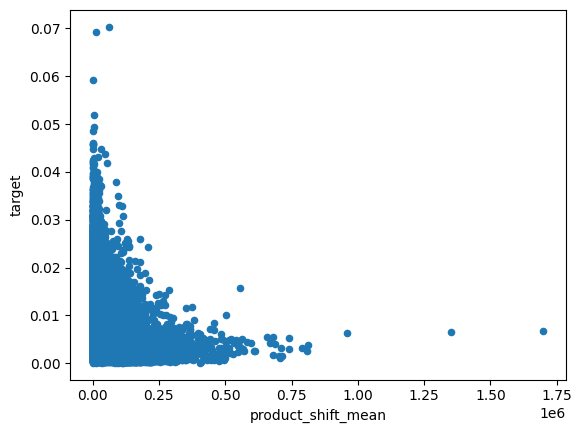

In [19]:
df.plot.scatter(x='product_shift_mean',y='target')

<Axes: xlabel='timefunc', ylabel='target'>

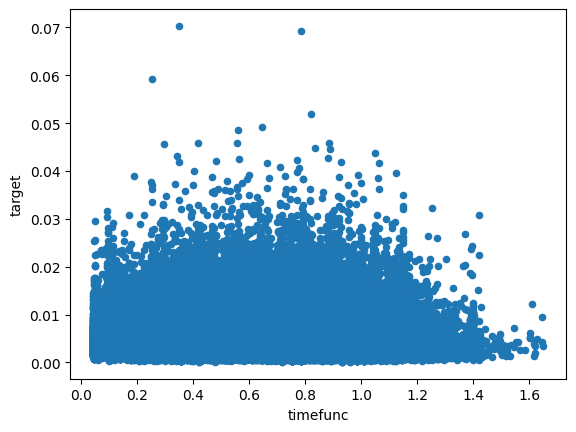

In [20]:
df.plot.scatter(x='timefunc',y='target')

In [21]:
np.abs(df.corr().target).sort_values()

log_time_diff_<lambda_0>              0.002029
time_id                               0.010341
log_time_diff_skew                    0.012536
stock_id                              0.021662
price_mult_median                     0.031719
time_diff                             0.031866
total_book_size_std                   0.035259
size                                  0.036413
log_time_diff_mean                    0.041468
order_count_<lambda_0>                0.046135
product_shift_sum                     0.046244
product_shift_<lambda_0>              0.050263
book_density_abs_impact_skew          0.052270
book_density_abs_impact_<lambda_0>    0.053265
log_time_diff_std                     0.053586
order_count_skew                      0.057726
total_book_size_sum                   0.061399
product_shift_skew                    0.062390
intercept_size                        0.064734
timefunc                              0.064945
log_time_diff                         0.065225
product_shift

In [22]:
df

,stock_id,time_id,sigma,target,size,spread,time_diff,log_time_diff,timefunc,order_count_mean,...,log_time_diff_skew,log_time_diff_<lambda_0>,shift_ratio,log_volume,sigma_volume,sigma_mean,alpha_time,intercept_size,score_int,beta_time
0,0,5,0.004499,0.004136,3179,7.922559,15,2.708050,0.310975,2.750000,...,1.324187,1.080160,0.782321,10.843970,0.048791,0.004438,-0.006319,290.384242,1.041037e-03,0.088887
1,0,11,0.001204,0.001445,1287,4.118409,23,3.135494,0.723982,1.896552,...,0.473900,-0.678131,0.833722,11.761504,0.014166,0.002186,-0.004980,299.686394,3.340334e-04,0.158994
2,0,16,0.002369,0.002168,2161,6.476585,35,3.555348,0.971598,2.720000,...,0.779598,-0.107140,0.991208,10.940737,0.025913,0.002269,0.007907,298.287863,6.365051e-04,0.212893
3,0,31,0.002574,0.002195,1962,7.627233,28,3.332205,0.849035,3.933333,...,0.255065,-1.337389,0.920999,10.318504,0.026558,0.002536,0.001888,289.948769,6.348169e-05,0.125077
4,0,62,0.001894,0.001747,1791,4.302926,25,3.218876,0.779443,4.045455,...,0.795882,-0.253400,0.802345,12.859037,0.024361,0.002011,0.004569,294.369789,2.160593e-04,0.195973
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
428905,126,32751,0.003691,0.003461,2570,8.478007,13,2.564949,0.309585,2.783784,...,1.070065,0.797306,0.843580,12.883514,0.047549,0.002945,0.000094,300.610564,2.307161e-07,0.090211
428906,126,32753,0.004104,0.003113,2085,6.312181,22,3.091042,0.788629,3.119048,...,0.636396,-1.044924,0.563549,13.313312,0.054636,0.002164,0.002168,298.643399,1.336517e-04,0.102470
428907,126,32758,0.003118,0.004070,3740,7.187954,24,3.178054,0.841990,2.800000,...,1.592612,1.540314,0.845722,13.538190,0.042206,0.002360,0.003777,294.284906,2.585615e-04,0.135559
428908,126,32763,0.003661,0.003357,9389,5.191397,4,1.386294,1.040582,2.925000,...,1.224870,-0.008115,0.860156,14.169151,0.051875,0.003050,0.000238,302.398938,5.356579e-06,0.037905


In [23]:
"""

_IncompleteInputError: incomplete input (969763094.py, line 1)

In [37]:
df2 = df.loc[:,np.abs(df.corr().target).sort_values().tail(21).index].rename(columns ={
    "spread": "spread_mean",
    "book_density_abs_impact_mean":"trade_impact",
    "total_book_size_skew" : "book_skew",
    "product_shift_mean" : "shift_mean",
    "order_count_std" : "order_std",
    "total_book_size_<lambda_0>" : "book_kurt",
    "spread_<lambda_0>" : "spread_kurt",
    "order_count_mean" : "order_mean",
    "product_shift_std": "shift_std",
    "log_time_diff" : "mean_logtime"
}).join(df[['stock_id','time_id']]).dropna().drop(columns = 'sigma_volume')

In [38]:
df2.columns

Index(['mean_logtime', 'shift_std', 'alpha_time', 'spread_skew', 'order_mean',
       'beta_time', 'spread_kurt', 'book_kurt', 'order_std', 'score_int',
       'shift_mean', 'book_skew', 'log_volume', 'shift_ratio', 'trade_impact',
       'sigma_mean', 'spread_std', 'spread_mean', 'sigma', 'target',
       'stock_id', 'time_id'],
      dtype='object')

In [39]:
def soft_norm(series, lower_pct=5, upper_pct=95, epsilon=1e-8):

    lower_bound = np.percentile(series, lower_pct)
    upper_bound = np.percentile(series, upper_pct)
    
    scaled = (series - lower_bound) / (upper_bound - lower_bound)

    normalized = 1 / (1 + np.exp(-10 * (scaled - 0.5)))

    
    return normalized


    

In [ ]:
numeric_cols = df2.select_dtypes(include=[np.number]).columns

cols_to_exclude = {'stock_id', 'time_id', 'target', 'sigma'}
for col in numeric_cols:
    if col not in cols_to_exclude:
        df2[f"{col}"] = soft_norm(df2[col], lower_pct=1, upper_pct=99)

In [ ]:
df2.plot.scatter(x="sigma", y ="target",s=.1)

df2.plot.scatter(x="sigma", y ="spread_mean",s=.001)

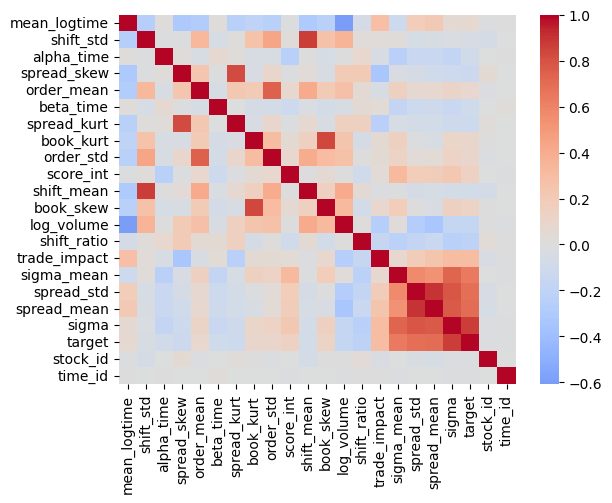

In [42]:
sns.heatmap(df2.select_dtypes(include=[np.number]).corr(), annot=False, fmt='.2f', cmap='coolwarm', center=0).figure.savefig('correlation_heatmap.png', dpi=150, bbox_inches='tight')

In [59]:
import seaborn as sns
sns.pairplot(df.query("""stock_id==1""")).figure.savefig('scatter_matrix.png')

In [ ]:
sns.PairGrid(df2.query("""stock_id==1""").select_dtypes(include=[np.number])).map_diag(plt.hist).map_offdiag(plt.hexbin, gridsize=30).figure.savefig('hexbin_pairwise.png')

In [43]:
df2.to_csv("baseline5.csv")

In [44]:
"""
def soft_norm(series, low=-0.01, high=0.01):
    median_abs = np.median(np.abs(series))
    scaled = series / (median_abs + 1e-10) * 2
    transformed = scaled / (1 + np.abs(scaled))
    result = pd.Series(np.nan, index=series.index)
    result = low + (transformed + 1) * (high - low) / 2
    return result

size_slope = trades.groupby(['stock_id', 'time_id']).apply(
    lambda g: np.polyfit(g['seconds_in_bucket'], np.log(g['size']), 1)[0]
    if len(g) >= 2 else 1
)



df['slopes'] = pd.Series(soft_norm(size_slope)).values

df.plot.scatter(x='slopes',y='target',c='stock_id')
"""


"\ndef soft_norm(series, low=-0.01, high=0.01):\n    median_abs = np.median(np.abs(series))\n    scaled = series / (median_abs + 1e-10) * 2\n    transformed = scaled / (1 + np.abs(scaled))\n    result = pd.Series(np.nan, index=series.index)\n    result = low + (transformed + 1) * (high - low) / 2\n    return result\n\nsize_slope = trades.groupby(['stock_id', 'time_id']).apply(\n    lambda g: np.polyfit(g['seconds_in_bucket'], np.log(g['size']), 1)[0]\n    if len(g) >= 2 else 1\n)\n\n\n\ndf['slopes'] = pd.Series(soft_norm(size_slope)).values\n\ndf.plot.scatter(x='slopes',y='target',c='stock_id')\n"

In [45]:
df2.columns

Index(['mean_logtime', 'shift_std', 'alpha_time', 'spread_skew', 'order_mean',
       'beta_time', 'spread_kurt', 'book_kurt', 'order_std', 'score_int',
       'shift_mean', 'book_skew', 'log_volume', 'shift_ratio', 'trade_impact',
       'sigma_mean', 'spread_std', 'spread_mean', 'sigma', 'target',
       'stock_id', 'time_id'],
      dtype='object')

In [46]:
df2.corr().target

mean_logtime    0.064672
shift_std      -0.039319
alpha_time     -0.089808
spread_skew    -0.128919
order_mean      0.083269
beta_time      -0.097212
spread_kurt    -0.110399
book_kurt       0.090902
order_std       0.097819
score_int       0.133542
shift_mean     -0.078818
book_skew       0.126577
log_volume     -0.166196
shift_ratio    -0.215217
trade_impact    0.298440
sigma_mean      0.642562
spread_std      0.689535
spread_mean     0.695460
sigma           0.873830
target          1.000000
stock_id       -0.021840
time_id        -0.010355
Name: target, dtype: float64

<Axes: ylabel='Frequency'>

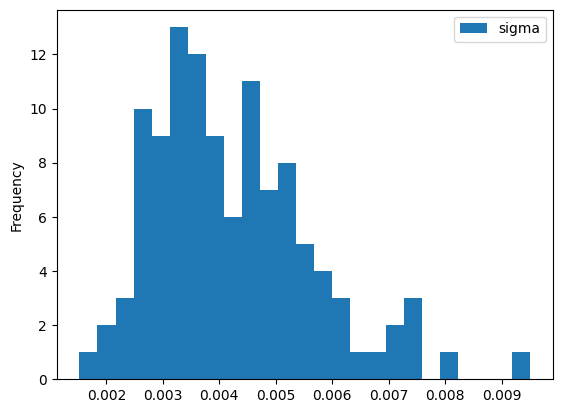

In [58]:
df2.groupby("stock_id").agg({"sigma": "mean"}).plot.hist(bins=25)